## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## Camera Calibration

#### Find Corners in Test Images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

#### Calculate Coefficients Using Chessboard Points

In [2]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

def undistort(image):
    return cv2.undistort(image, mtx, dist, None, mtx)

#### Verify Undistort on Test Images

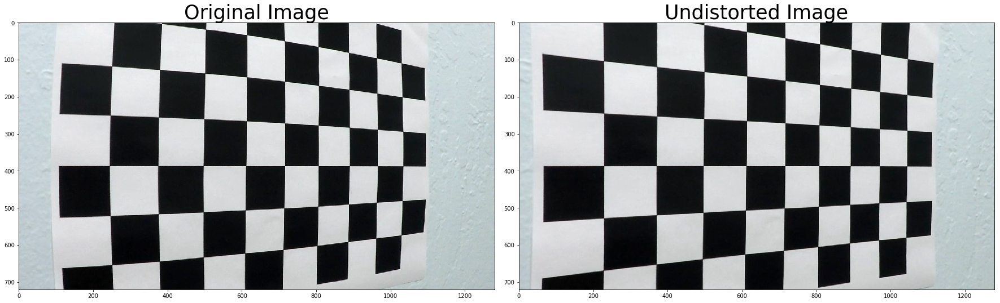

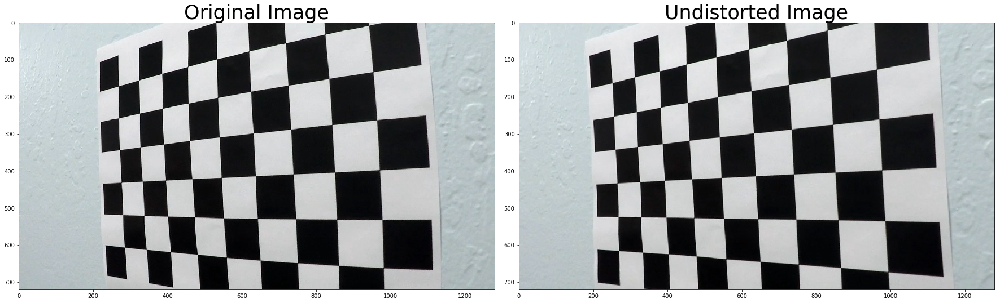

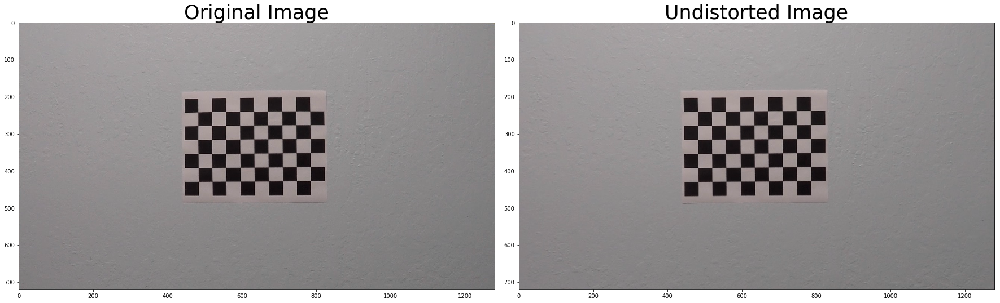

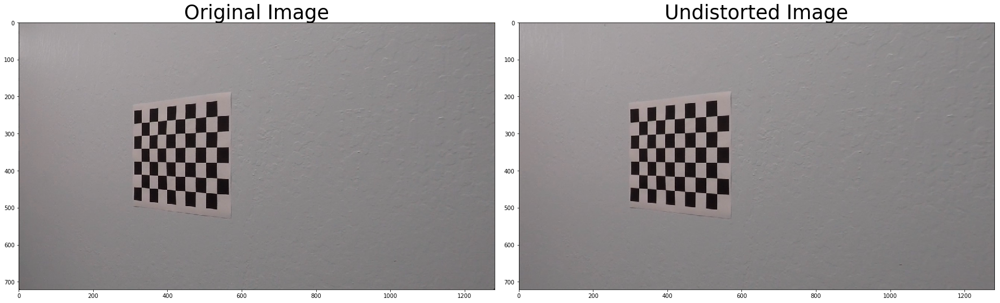

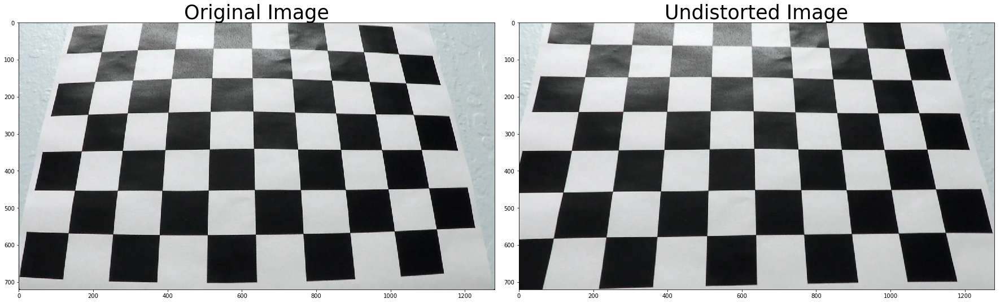

...

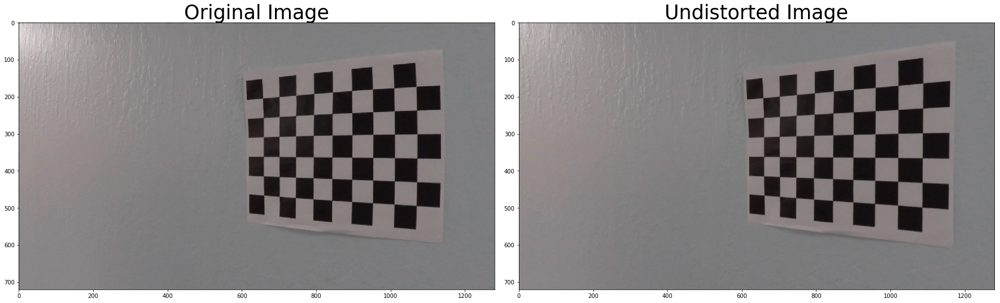

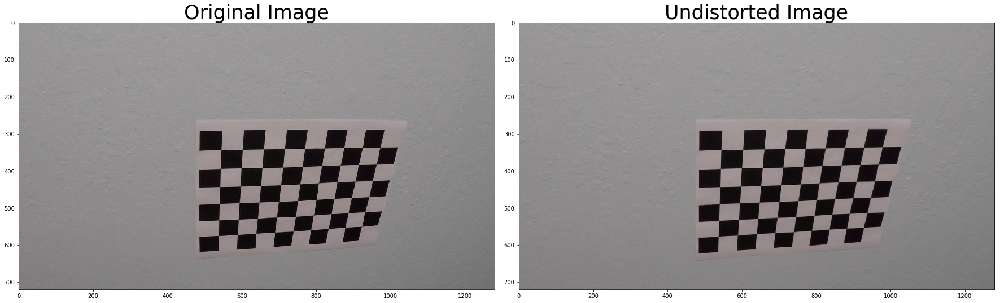

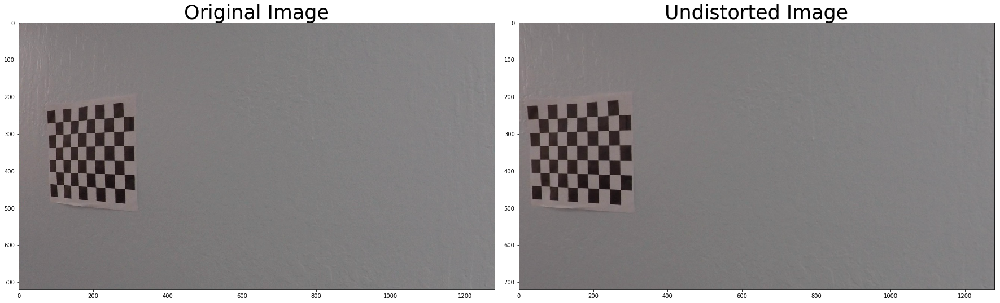

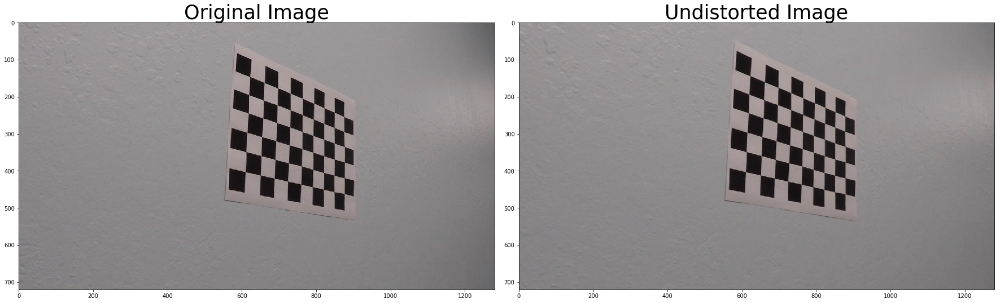

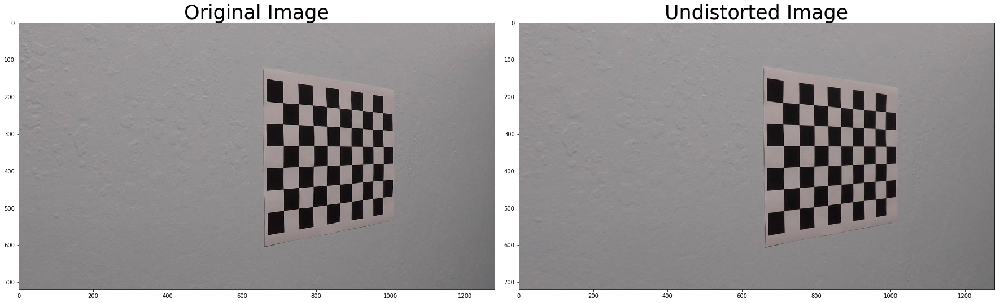

In [3]:
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    
    dst = undistort(img)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=35)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=35)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Perspective Transform

#### Draw Lane Polygon

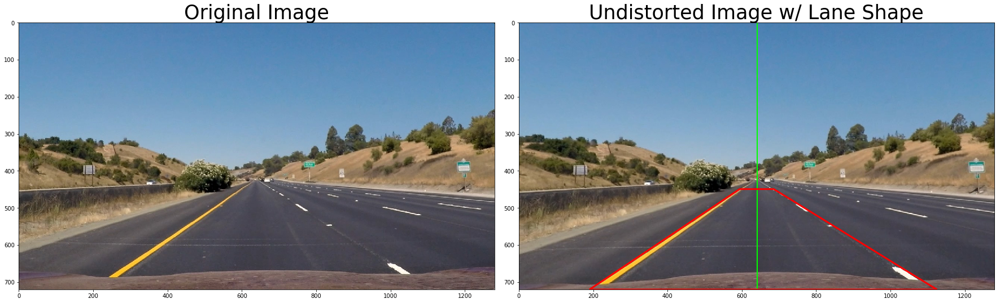

In [4]:
import matplotlib.patches as patches

img = cv2.imread("test_images/straight_lines1.jpg")
img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

# Undistort Image
undist = undistort(img)

undist = cv2.line(undist, (640, 0), (640, 720), (0,255,0), 2)
# 132 wide
# Lane polygon coordinates
x = [1125, 686, 594, 190]
y = [720, 449, 449, 720]
92
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=35)
ax2.add_patch(patches.Polygon(xy=list(zip(x,y)), fill=False, color="red", linewidth=3))
ax2.imshow(undist)
ax2.set_title('Undistorted Image w/ Lane Shape', fontsize=35)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#### Calculate Transform Map

In [5]:
# Source Points
src_pts = np.float32([[190, 720], [1125, 720], [686, 449], [594, 449]])
# Destination Points
dst_pts = np.float32([[320, 720], [960, 720], [960, 0], [320, 0]])
# Calculate Transform Map
M = cv2.getPerspectiveTransform(src_pts, dst_pts)
# Calculate Inverse Transform Map
Minv = cv2.getPerspectiveTransform(dst_pts, src_pts)

#### Define Perspective Transform

In [6]:
# Transform image
def warp_image(image):
    img_size = (image.shape[1], image.shape[0])
    warped = cv2.warpPerspective(image, M, img_size)
    return warped

# Transform image
def unwarp_image(image):
    img_size = (image.shape[1], image.shape[0])
    unwarped = cv2.warpPerspective(image, Minv, img_size)
    return unwarped

#### Verify Perspective Transform on Test Image

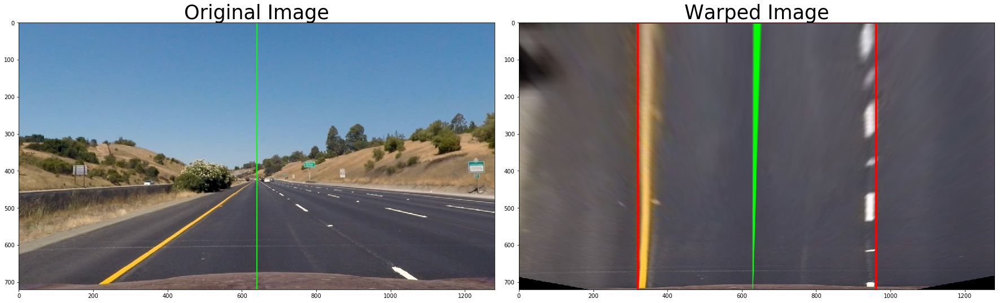

In [7]:

warp = warp_image(undist)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(undist)
ax1.set_title('Original Image', fontsize=35)
ax2.add_patch(patches.Polygon(xy=list(dst_pts), fill=False, color="red", linewidth=3))
ax2.imshow(warp)
ax2.set_title('Warped Image', fontsize=35)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Image Thresholding

#### Threshold Functions

In [8]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg



def abs_sobel_thresh(image, orient='x', sobel_kernel=3, thresh=(0, 255)):
    if orient == 'x':
        x, y = 1, 0
    else:
        x, y = 0, 1
    sobel = cv2.Sobel(image, cv2.CV_64F, x, y, ksize=sobel_kernel)
    abs_sobel = np.absolute(sobel)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return grad_binary

def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    abs_sobel = np.sqrt(sobelx*sobelx + sobely*sobely)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    mag_binary = np.zeros_like(scaled_sobel)
    mag_binary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    return mag_binary

def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    x_abs = np.absolute(sobelx)
    y_abs = np.absolute(sobely)
    dir_gradient = np.arctan2(y_abs, x_abs)
    dir_binary = np.zeros_like(dir_gradient)
    dir_binary[(dir_gradient >= thresh[0]) & (dir_gradient <= thresh[1])] = 1
    return dir_binary

def chan_threshold(chan, thresh=(170, 255)):
    chan = np.uint8(255.0*chan/np.max(chan))
    c_binary = np.zeros_like(chan)
    c_binary[(chan > thresh[0]) & (chan <= thresh[1])] = 1
    return c_binary

def threshold_image(image):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    
    # Choose a Sobel kernel size
    ksize = 3 # Choose a larger odd number to smooth gradient measurements

    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(30, 255))
    grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(30, 255))
    mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(40, 255))
    dir_binary = dir_threshold(gray, sobel_kernel=15, thresh=(0.7, 1.3))
    s_binary = chan_threshold(hls[:,:,2], thresh=(100, 255))

    combined = np.zeros_like(dir_binary)
#     combined[((gradx == 1) & (grady == 1)) & (((mag_binary == 1) | (s_binary == 1)) & ( dir_binary == 1))] = 1
    combined[(((gradx == 1) | (s_binary == 1)) & ( dir_binary == 1))] = 1
    return combined

#### Verify Threshold Functions Individually

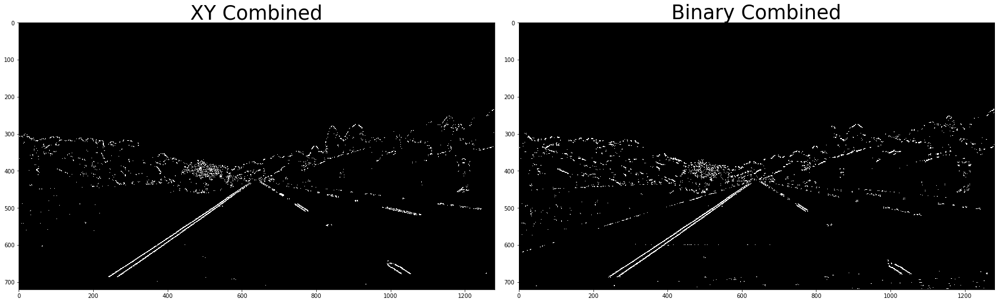

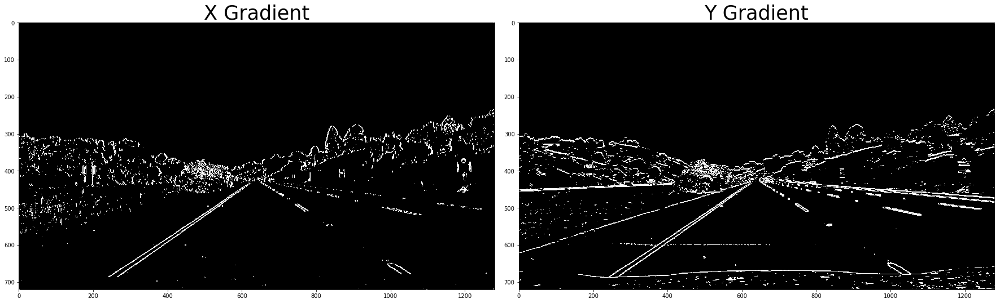

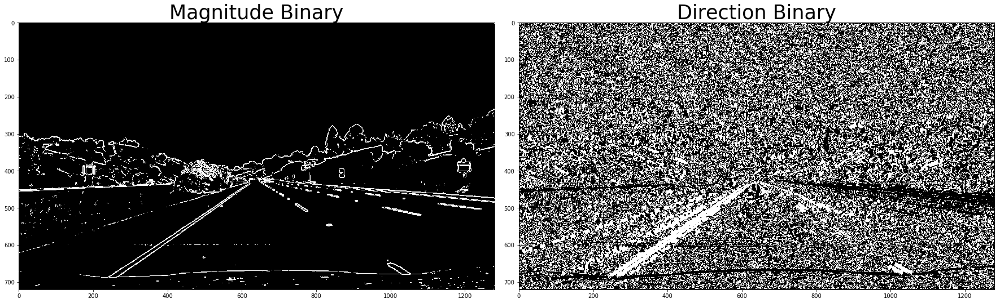

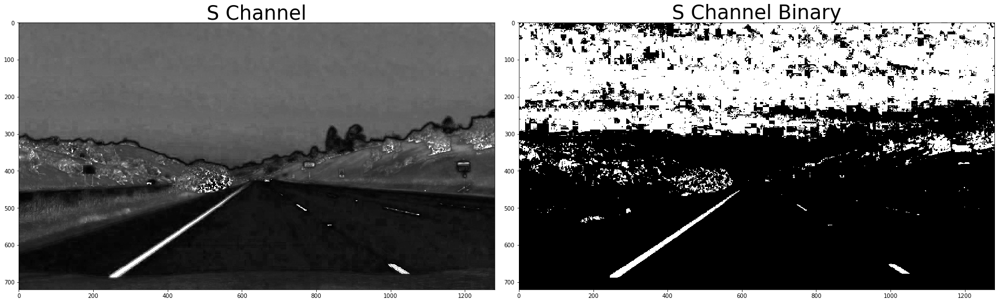

In [9]:
image =  cv2.imread('test_images/straight_lines1.jpg')

gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
hls = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)

# Choose a Sobel kernel size
ksize = 3 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(30, 255))
grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(30, 255))
mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(40, 255))
dir_binary = dir_threshold(gray, sobel_kernel=15, thresh=(0.7, 1.3))
s_binary = chan_threshold(hls[:,:,2], thresh=(100, 255))

# Plot the results
xy_combined = np.zeros_like(dir_binary)
bi_combined = np.zeros_like(dir_binary)
xy_combined[((gradx == 1) & (grady == 1))] = 1
bi_combined[((mag_binary == 1) & (dir_binary == 1))] = 1
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(xy_combined, cmap='gray')
ax1.set_title('XY Combined', fontsize=35)
ax2.imshow(bi_combined, cmap='gray')
ax2.set_title('Binary Combined', fontsize=35)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(gradx, cmap='gray')
ax1.set_title('X Gradient', fontsize=35)
ax2.imshow(grady, cmap='gray')
ax2.set_title('Y Gradient', fontsize=35)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(mag_binary, cmap='gray')
ax1.set_title('Magnitude Binary', fontsize=35)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Direction Binary', fontsize=35)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(hls[:,:,2], cmap='gray')
ax1.set_title('S Channel', fontsize=35)
ax2.imshow(s_binary, cmap='gray')
ax2.set_title('S Channel Binary', fontsize=35)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#### Verify Combined Threshold Function

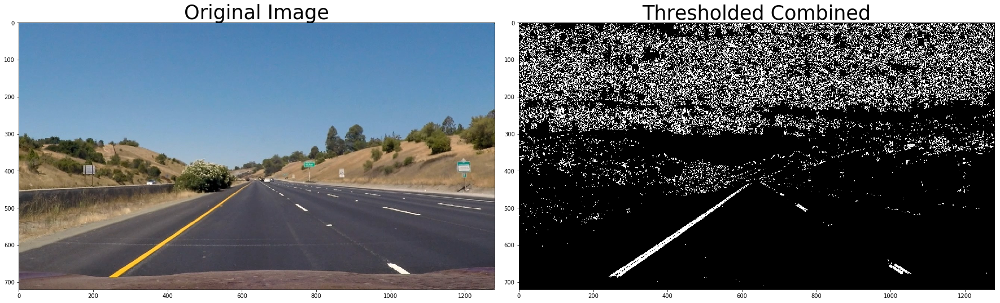

In [10]:
combined = threshold_image(image)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
ax1.set_title('Original Image', fontsize=35)
ax2.imshow(combined, cmap='gray')
ax2.set_title('Thresholded Combined', fontsize=35)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Preprocess Image

#### Preprocess Function

In [11]:
def process_image(image, thresh_f=0.8):
    undist = undistort(image)
    thresh = threshold_image(undist)
    # warped = warp_image(thresh)
    final = warp_image(thresh)
    final[final > thresh_f] = 1
    return final



#### Verify Preprocessed Image

Text(0.5,1,'Processed Image')

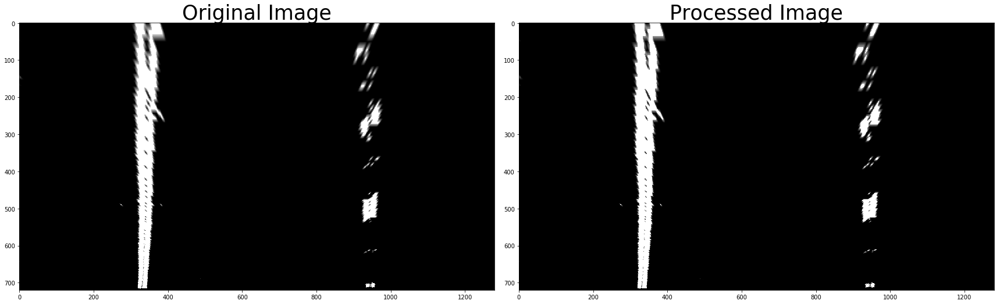

In [12]:
img = cv2.imread("test_images/straight_lines1.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

out = process_image(img)
final = process_image(img)
final[final > 0.6] = 1
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.set_title('Original Image', fontsize=35)
ax1.imshow(out, cmap='gray')
ax2.imshow(final, cmap='gray')
ax2.set_title('Processed Image', fontsize=35)

In [13]:
ui = np.uint8(final)
print(len(ui.nonzero()[0]))
print(ui[0][293], ui[0][294])
print(out[0][293], out[0][294])
a = [0.5, 0.75, 0.99, 1.0]
print(np.uint8(a))


34021
0 0
0.0 0.0
[0 0 0 1]


## Identify Lane Lines

#### Inspect Lower Half Pixel Histogram

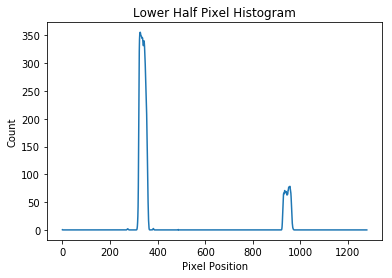

In [14]:
histogram = np.sum(out[out.shape[0]//2:,:], axis=0)
plt.plot(histogram)
plt.title("Lower Half Pixel Histogram")
plt.ylabel("Count")
plt.xlabel("Pixel Position")
plt.show()

#### Lane Detection Functions

In [15]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def window_search(binary_warped, nonzeroy, nonzerox, nwindows=9, margin=100, minpix=75):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    bwarp_8 = np.uint8(binary_warped)
    out_img = np.dstack((bwarp_8, bwarp_8, bwarp_8))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 3) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 3) 
        # Identify the nonzero pixels in x and y within the window
        # provides nonzeroy index position for pixels in the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        # I could set some threshold here to only capture data that is reasonably peaked.
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            # could potentially draw the updates here
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:  
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    return left_lane_inds, right_lane_inds, out_img

def margin_search(binary_warped, nonzeroy, nonzerox, l_line, r_line, margin=100):
    
    left_lane_inds = ((nonzerox > (l_line.current_fit[0]*(nonzeroy**2) + l_line.current_fit[1]*nonzeroy + 
    l_line.current_fit[2] - margin)) & (nonzerox < (l_line.current_fit[0]*(nonzeroy**2) + 
    l_line.current_fit[1]*nonzeroy + l_line.current_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (r_line.current_fit[0]*(nonzeroy**2) + r_line.current_fit[1]*nonzeroy + 
    r_line.current_fit[2] - margin)) & (nonzerox < (r_line.current_fit[0]*(nonzeroy**2) + 
    r_line.current_fit[1]*nonzeroy + r_line.current_fit[2] + margin)))  
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([l_line.current_x-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([l_line.current_x+margin, 
                                  ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([r_line.current_x-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([r_line.current_x+margin, 
                                  ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return left_lane_inds, right_lane_inds, result
    

def fit_polynomial(y, x):
    # Fit a second order polynomial
    fit = np.polyfit(y, x, 2)
    return fit

def calculate_radius(ploty, fit, ym_per_pix=33/720, xm_per_pix=3.7/680):
    y_eval = np.max(ploty)
    
    fitx = fit[0]*ploty**2 + fit[1]*ploty + fit[2]
    
    # Fit new polynomials to x,y in world space
    fit_cr = np.polyfit(ploty*ym_per_pix, fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    curverad = ((1 + (2*fit_cr[0]*y_eval*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
    # Now our radius of curvature is in meters
    return curverad

#### Verify Lane Detection Functions

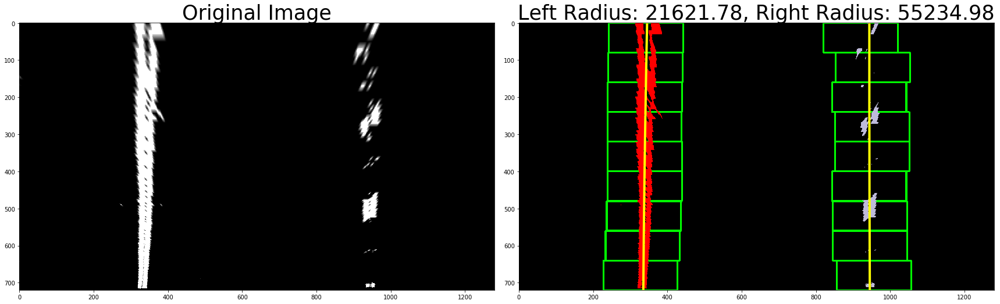

In [16]:
# Generate Function Data
img = cv2.imread("test_images/straight_lines1.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
processed = process_image(img)


nonzero = np.uint8(processed).nonzero()
# array of y coordinates of nonzero pixels.
nonzeroy = np.array(nonzero[0])
# array of x coordinates of nonzero pixels.
nonzerox = np.array(nonzero[1])

# returns index pos of nonzeroy/nonzerox values in window
left_inds, right_inds, out_img = window_search(processed, nonzeroy, nonzerox)

# y/x coordinates of nonzero pixels in left windows
leftx = nonzerox[left_inds]
lefty = nonzeroy[left_inds] 
# y/x coordinates of nonzero pixels in right windows
rightx = nonzerox[right_inds]
righty = nonzeroy[right_inds] 

# fit polynomial to left and right lane lines
left_fit, right_fit = fit_polynomial(lefty, leftx), fit_polynomial(righty, rightx)
ploty = np.linspace(0, out.shape[0]-1, out.shape[0] )
# calculate radius of polynomial
left_radius, right_radius = calculate_radius(ploty, left_fit), calculate_radius(ploty, right_fit)

# plot lane detection
ploty = np.linspace(0, processed.shape[0]-1, processed.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_inds], nonzerox[left_inds]] = [255, 0, 0]
out_img[nonzeroy[right_inds], nonzerox[right_inds]] = [190,186,218]

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

# cv2.cvtColor(processed.astype(np.uint8),cv2.COLOR_GRAY2RGB)
ax1.imshow(processed, cmap='gray')
ax1.set_title('Original Image', fontsize=35)
ax2.imshow(out_img)
ax2.set_title('Left Radius: {0}, Right Radius: {1}'.format(round(left_radius,2), round(right_radius,2)), fontsize=35)
ax2.plot(left_fitx, ploty, color='yellow', linewidth=4)
ax2.plot(right_fitx, ploty, color='yellow', linewidth=4)

#### Validate Fit and Radius on Synthetic Data

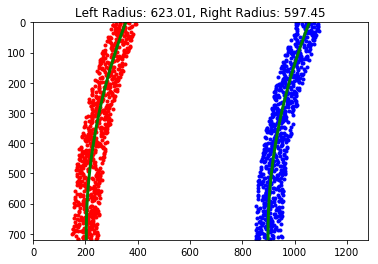

In [17]:
import numpy as np
import matplotlib.pyplot as plt
# Generate some fake data to represent lane-line pixels
ploty = np.linspace(0, 719, num=720)# to cover same y-range as image
quadratic_coeff = 3e-4 # arbitrary quadratic coefficient
# For each y position generate random x position within +/-50 pix
# of the line base position in each case (x=200 for left, and x=900 for right)
leftx = np.array([200 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                              for y in ploty])
rightx = np.array([900 + (y**2)*quadratic_coeff + np.random.randint(-50, high=51) 
                                for y in ploty])

leftx = leftx[::-1]  # Reverse to match top-to-bottom in y
rightx = rightx[::-1]  # Reverse to match top-to-bottom in y

left_inds = np.stack((leftx, ploty), axis=-1)
right_inds = np.stack((rightx, ploty), axis=-1)

left_fit, right_fit = fit_polynomial(ploty, leftx), fit_polynomial(ploty, rightx)

left_radius, right_radius = calculate_radius(ploty, left_fit), calculate_radius(ploty, right_fit)

# Generate x values for fit
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

# Plot up the fake data
mark_size = 3
plt.plot(leftx, ploty, 'o', color='red', markersize=mark_size)
plt.plot(rightx, ploty, 'o', color='blue', markersize=mark_size)
plt.xlim(0, 1280)
plt.ylim(0, 720)
plt.plot(left_fitx, ploty, color='green', linewidth=3)
plt.plot(right_fitx, ploty, color='green', linewidth=3)
plt.title("Left Radius: {0}, Right Radius: {1}".format(round(left_radius, 2), round(right_radius, 2)))
plt.gca().invert_yaxis() # to visualize as we do the images

## Line Class

#### Holds/Computes Lane Line Measurements

In [18]:
class Line():
    def __init__(self, frames=6, shape=(720,1280)):
        
        self.ploty = np.linspace(0, shape[0]-1, shape[0])
        #number of frames used for averaging
        self.frames = frames
        #number of diffs below threshold
        self.bad_diffs = 0

        self.detected = False  
        
        #average x values of the fitted line over the last n iterations
        self.best_x = None
        #x values of the fitted line over the last iteration
        self.current_x = None
        
        #polynimial coefficients of last n fits
        self.recent_fits = []
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None
        
        #difference in fit coefficients between last and new fits
        self.diffs = None
        
        #radius of curvature of the line in some meters
        self.radius_of_curvature = None # calculate value
        
        #distance in meters of vehicle center from the line
        self.line_base_pos = None #calc value
        
    def update(self, fit):
        self.current_fit = fit
        
        if self.diffs is None:
            self.diffs = np.array([0,0,0], dtype='float') 
        else:
            self.diffs = np.absolute(self.best_fit - self.current_fit)
            
        if self.diffs[0] > 0.00025:
            self.bad_diffs += 1
            if self.bad_diffs >= self.frames:
                #margin search is failing. reset bad_diffs
                self.detected = False
                self.recent_fits = []
                self.bad_diffs = 0
                self.diffs = None
            return
            
        if len(self.recent_fits) > self.frames:
            self.recent_fits.pop(0)
        
        self.detected = True
        self.recent_fits.append(self.current_fit)
        self.best_fit = np.mean(self.recent_fits, axis=0)
        self.best_x = self.best_fit[0]*self.ploty**2 + self.best_fit[1]*self.ploty + self.best_fit[2]
        self.current_x = self.current_fit[0]*self.ploty**2 + self.current_fit[1]*self.ploty + self.current_fit[2]
        self.radius_of_curvature = calculate_radius(self.ploty, self.best_fit)
        
        self.lane_intercept = self.best_fit[0]*np.max(self.ploty)**2 + self.best_fit[1]*np.max(self.ploty) + self.best_fit[2]
        
        
left_line = Line()
right_line = Line()    


## Lane Detection Pipeline

In [19]:
def detect_frame_line(processed, left_line=False, right_line=False):
    
    nonzero = np.uint8(processed).nonzero()
    # array of y coordinates of nonzero pixels.
    nonzeroy = np.array(nonzero[0])
    # array of x coordinates of nonzero pixels.
    nonzerox = np.array(nonzero[1])
    
    if not left_line.detected and not right_line.detected:
        left_inds, right_inds, out_img = window_search(processed, nonzeroy, nonzerox)
    elif not left_line.detected and right_line.detected:
        junk, right_inds, out_img = margin_search(processed, nonzeroy, nonzerox, left_line, right_line)
        left_inds, junk, out_img = window_search(processed, nonzeroy, nonzerox)
    elif left_line.detected and not right_line.detected:
        left_inds, junk, out_img = margin_search(processed, nonzeroy, nonzerox, left_line, right_line)
        junk, right_inds, out_img = window_search(processed, nonzeroy, nonzerox)
    else:
        left_inds, right_inds, out_img = margin_search(processed, nonzeroy, nonzerox, left_line, right_line)
    
    # y/x coordinates of nonzero pixels in left windows
    leftx = nonzerox[left_inds]
    lefty = nonzeroy[left_inds] 
    # y/x coordinates of nonzero pixels in right windows
    rightx = nonzerox[right_inds]
    righty = nonzeroy[right_inds] 
    
    # fit polynomial to left and right lane lines
    left_fit, right_fit = fit_polynomial(lefty, leftx), fit_polynomial(righty, rightx)
    
    left_line.update(left_fit)
    right_line.update(right_fit)
    
    out_img[nonzeroy[left_inds], nonzerox[left_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_inds], nonzerox[right_inds]] = [190,186,218]
    
    return left_fit, right_fit, out_img


def revert_frame(ploty, left_fitx, right_fitx, warped, undist):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = unwarp_image(color_warp) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    return result
        
        


def frame_lane_detection_pipeline(img, left_line=left_line, right_line=right_line):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    processed = process_image(img)
    
    left_fit, right_fit, out_img = detect_frame_line(processed, left_line, right_line)
    
    left_fitx = left_line.best_x
    right_fitx = right_line.best_x
    output = revert_frame(ploty, left_fitx, right_fitx, processed, img)
    
    rad = np.mean([left_line.radius_of_curvature, right_line.radius_of_curvature])
    # annotate with radius
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(output, "Radius: {0}m".format(int(round(rad))), (40,40), font, 1.5,(37,37,37),3)
    font = cv2.FONT_HERSHEY_SIMPLEX
    # DEBUGGING
    #cv2.putText(output, "Left Radius: {0}".format(round(left_line.radius_of_curvature)), (40,40), font, 1.5,(37,37,37),3)
    #cv2.putText(output, "Right Radius: {0}".format(round(right_line.radius_of_curvature)), (40,100), font, 1.5,(37,37,37),3)
    #cv2.putText(out_img, "Left Radius: {0}".format(round(left_line.radius_of_curvature)), (40,40), font, 1.5,(240,240,240),3)
    #cv2.putText(out_img, "Right Radius: {0}".format(round(right_line.radius_of_curvature)), (40,100), font, 1.5,(240,240,240),3)

    # calculate offset from lane center
    xm_per_pix = 3.7/680
    lane_center = (left_line.lane_intercept + right_line.lane_intercept) / 2
    offset = (640 - lane_center) * xm_per_pix
    abs_offset = round(np.absolute(offset),2)
    offset_form = "Vehicle is {0}m {1} of center"
    if offset >= 0:
        offset_text = offset_form.format(abs_offset, "right")
    else:
        offset_text = offset_form.format(abs_offset, "left")
    cv2.putText(output, offset_text, (40,100), font, 1.5,(37,37,37),3)
    
    return cv2.cvtColor(output, cv2.COLOR_RGB2BGR) #out_img

In [20]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

white_output = 'project_video_result-01.mp4'

clip1 = VideoFileClip("project_video.mp4")#.subclip(30,32)
white_clip = clip1.fl_image(frame_lane_detection_pipeline)
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video project_video_result-01.mp4
[MoviePy] Writing video project_video_result-01.mp4


100%|█████████▉| 1260/1261 [06:52<00:00,  2.68it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_result-01.mp4 

CPU times: user 6min 30s, sys: 1min 34s, total: 8min 5s
Wall time: 6min 54s
